# EM Algorithm for NMF

## Author : Cyril Equilbec

The goal of this project is to derive and apply the EM algorithm to a non-negative factorization problem on the dataset : AT&T Database of Faces (available [here](https://www.cl.cam.ac.uk/research/dtg/attarchive/facedatabase.html)).

# Introduction

This dataset contains face images from 40 distinct subjects, where there are 10 images for each subject.  In total there are 400 images in the dataset, where the size of each image is $92 \times 112$ pixels, with 256 gray levels per pixel.

The goal of the experiment is to obtain a "parts-based-representation" of faces by learning an NMF model on this dataset.  Our hope is that, when we estimate the matrices $W$ and $H$ by using $V$, the columns of $W$ will correspond to some images that only contain a particular part of a face.

### NB : This notebook might be very long to rerun from scratch as it runs the algorithm with a lot of different parameters and does lot of plots.

In [2]:
import scipy.io
from scipy import ndimage
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import NMF
%matplotlib inline

# load data set
# each column of V corresponds to a given image
data_set = scipy.io.loadmat('data/attfaces.mat')
V = data_set['V']
# features = vectorized matrix of 92 * 112 pixels
# samples  = 400 images
n_features, n_samples = V.shape
img_shape = (92,112)
print("dataset shape : ", (n_features, n_samples))
print("picture shape : ", img_shape)

dataset shape :  (10304, 400)
picture shape :  (92, 112)


In [14]:
# simple function to reshape, rotate and plot a given image from the dataset
def plot_rotate_img(img, img_shape=img_shape):
    vmax = max(img.max(), -img.min())
    sample = img.reshape(img_shape)
    rotated_img = ndimage.rotate(sample, -90)
    plt.imshow(rotated_img, cmap=plt.cm.gray,
                   interpolation='nearest',
                   vmin=-vmax, vmax=vmax)
    

# function to plot every column of a given matrix, code adapted from :
# https://scikit-learn.org/stable/auto_examples/decomposition/plot_faces_decomposition.html#sphx-glr-auto-examples-decomposition-plot-faces-decomposition-py
def plot_gallery(title, images, n_col=5, n_row=5, size_title = 25, save=False):
    plt.figure(figsize=(2. * n_col, 2.26 * n_row))
    plt.suptitle(title).set_fontsize(size_title)
    for i, comp in enumerate(images):
        plt.subplot(n_row, n_col, i + 1)
        plot_rotate_img(comp)
        plt.xticks(())
        plt.yticks(())
    plt.subplots_adjust(0.01, 0.05, 0.99, 0.93, 0.04, 0.)
    if save:
        plt.savefig("img/" + title + ".png")
        plt.close()
    else:
        plt.show()
 



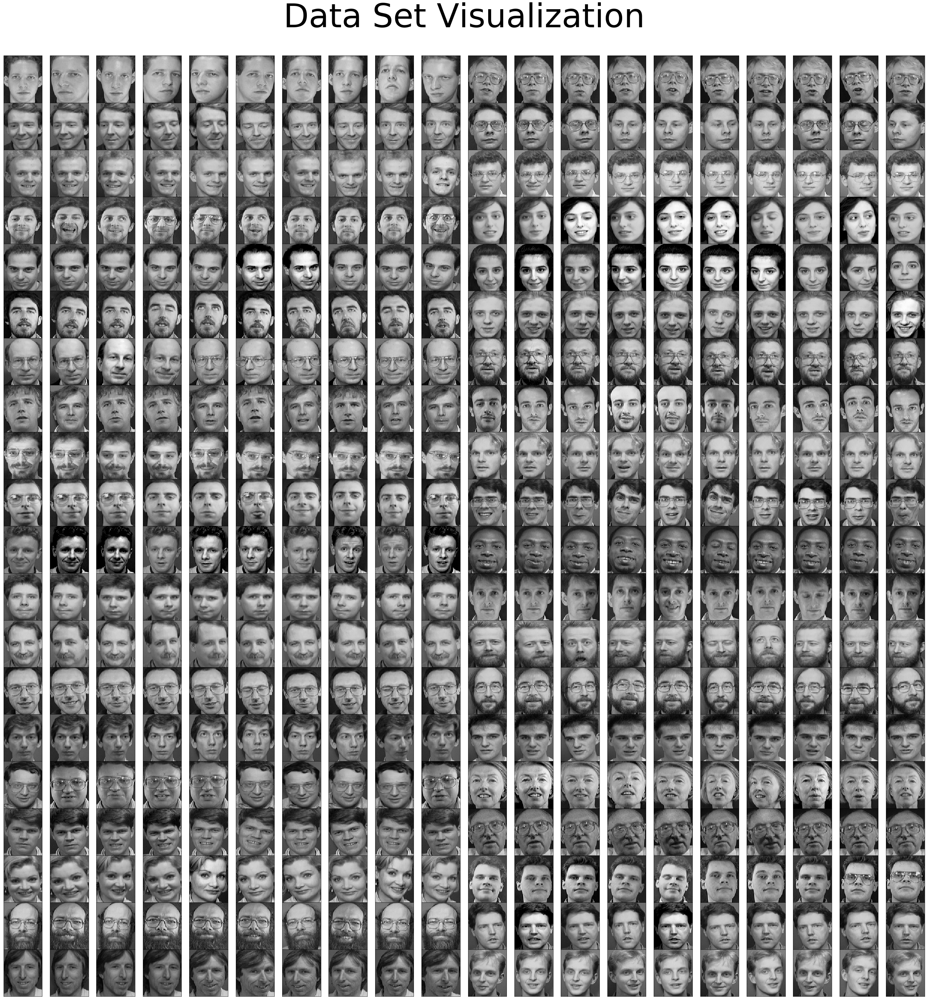

In [16]:
plot_gallery("Data Set Visualization", V.T, 20, 20, 100)

# Some intuition about the algorithm

The aim of this algorithm is to factorize a certain matrix $V \in \mathbb{R}_+^{M \times N}$ into a product of two *non-negative* matrices $W \in \mathbb{R}_+^{M \times K}$, called the *template matrix*, and $H \in \mathbb{R}_+^{M \times K}$, called the *excitation matrix*, such that : $$V \approx WH$$



*Nb : $N$ is the number of samples, $M$ the number of features and $K$ the number of "components" or "trends" captured. Each column of $V$ is a vectorized image, $n$ refers to a given sample (column) and $m$ refers to a given feature (row) such that $v_{mn}$ refers to the m-th pixel (feature) of the n-th sample.*


The non-negativity is inherent from the data considered, in our case the data set is a collection of pictures which implies the non-negativity of the pixels $v_{ij}$


The matrix $W$ will capture the "trends" in the data set while the matrix $H$ will store the weights of those "trends". Furthermore, one can view a given column $V_j$ as $V_j = WH_j$ and therefore any element $v_{ij}$ can be written as : $$V_{ij} = \sum_{k=1}^K h_{kj} w_{ik}$$

Where the $w_{ik}$ are the i-th element of each column of $W$ and the $h_{kj}$ are the elements of j-th column of $H$ ($= H_j$). 

This shows that any column of $V$ can be viewed as a weighted combination of the columns of $W$, where the weights are stored in the matrix $H$

**In our problem, the goal will be to learn $K$ relevant facial features such that any face in the data set can be well reconstructed as a linear combination of those $K$ components given certain weights stored in the matrix $H$.**

# Problem Statement

The aim is to solve a maximum a posteriori probability (MAP) problem. In a general way, for a certain set of parameters $\theta$, the map estimate is given by : 
$$\hat \theta_{map}(x) = \underset{\theta}{\mathrm{argmax}} \ f(\theta \mid x)$$

In our case, it is given by : 

\begin{equation} \label{eq1}
\begin{split}
(W^*, H^*) & = \underset{W,H}{\mathrm{argmax}} \ \log p(W,H \mid V) \\
 & = \underset{W,H}{\mathrm{argmax}} \ \log \frac{p(V \mid W,H)p(W,H)}{p(V)} \\
  & = \underset{W,H}{\mathrm{argmax}} \ \log p(V \mid W,H) + \log p(W,H) -\log p(V) \\
    & = \underset{W,H}{\mathrm{argmax}} \ \log p(V \mid W,H) + \log p(W,H) 
\end{split}
\end{equation}

Or equivalently, $$(W^*, H^*) = \underset{W,H}{\mathrm{argmax}} \ \log p(V,W,H)$$

We also have : 



$$w_{mk}  \sim \mathcal{G}(w_{mk} ; \alpha_w, \beta_w)$$ 
$$h_{kn}  \sim \mathcal{G}(h_{kn} ; \alpha_h, \beta_h)$$
$$v_{mn} \mid w_{m,:}, h_{:,n}  \sim \mathcal{PO}(v_{mn} ; \sum_{k=1}^K w_{mk} h_{kn})$$

Where $\mathcal{G}$ is the Gamma distribution defined as : 
$$\mathcal{G}(w ; \alpha, \beta) = \frac{\beta^{\alpha}}{\Gamma(\alpha)}w^{\alpha -1} e^{-\beta w}$$

and $\mathcal{PO}$ is the Poisson distribution defined as :

$$\mathcal{PO}(s;\lambda) = e^{s \log \lambda - \lambda - \log \Gamma(s+1) }$$

One recall the superposition property of Poisson distributed random variables $ s_i \sim \mathcal{PO}(s_i;\lambda_i)$ : if $x = s_1 + ... + s_n$ then the marginal probability of $x$ is $p(x) = \mathcal{PO}(x;\sum\lambda_i)$





Using the data augmentation trick with a dummy variable $S$, the EM algorithm, as stated in the subject, is:

- E-Step : $\mathcal{L}_t(W,H) = \mathbb{E}\big[\log p(V,S,W,H)\big]_{p(S \mid V, W_t, H_t)}$ 
where $t$ denotes the time step.

- M-Step : $(W_{t+1}, H_{t+1}) = \underset{W,H}{\mathrm{argmax}}\ \mathcal{L}_t(W,H)$

# More Intuition and some Intermediate results

Following the hints given in class, we'll consider random variables $\{S_1...S_K \}$ called latent sources such that each $S_i \sim \mathcal{PO} (S_i, \lambda_i)$

Without redoing the whole course demonstration, we have shown in class that :

- $P(S_{1:K} \mid X) = \mathcal{M}(S_1...S_K \mid \frac{\lambda_1}{\sum \lambda_j}...\frac{\lambda_K}{\sum \lambda_j}, X) = \frac{X!}{S_1!...S_K!} (\frac{\lambda_1}{\sum \lambda_j})^{S_1}...(\frac{\lambda_K}{\sum \lambda_j})^{S_K}$ is a multinomial distribution.

- $S_1 ... S_K \sim \mathcal{M}(S_1...S_K \mid p_1 ... p_K, V) $ and $\mathbb{E}(S_i) = V p_i$

The goal is to find the parameter $\lambda_i$, as we have $v_{mn} = \sum_{k=1}^K s_{mnk}$ and $v_{mn} \sim \mathcal{PO}(v_{mn} ; \sum_{k=1}^K w_{mk} h_{kn})$, using the superposition property yields the desired result: 

$$s_{mnk} \sim \mathcal{PO} (s_{mnk}, w_{mk} h_{kn})$$ 




![Schema](img/schema.png)


This image gives more intuition about what is happening, if we use our notation instead, we can observe that every observation $v_{mn}$ is given by the sum over the laten sources associated : $v_{mn} = \sum_{k} s_{mnk}$ or in matrix notation : $V = \sum_{k} S_k$, where each latent source $s_{mnk}$ is Poisson distributed with intensity $w_{mk} h_{kn}$ and those $w_{mk}, h_{kn}$ are Gamma distributed according to some parameters : $\alpha_{w,h}, \beta_{w,h}$.

**We can already guess that a good initialization of those parameters will be crucial to generate a good decomposition.**



[Source:](https://www.cmpe.boun.edu.tr/~cemgil/papers/cemgil-tr609.pdf)  *Ali Taylan Cemgil,  “Bayesian inference for nonnegative matrix factorisation models,”Computational Intelligenceand Neuroscience, vol. 2009, 2009.3*


# Question 1 : Graphical Model

If we consider a given observation, $v_{mn}$, we know that it depends on every latent source $s_{mnk}$. If we fix $k$ and if we move along a given row $m$ then every latent sources depend on a given $w_{mk}$ ($m$ and $k$ are fixed as we consider the observations on a given row) and on every $h_{kn}$ (as we move along a row, the column index will change). Instead, if we consider for our graphical model the observations along a given column, we have to swap the roles of $h$ and $w$ but the structure remains the same. Hence the graphical model for a given row $m$ and a given index $k$ : 

![Graphical model](img/gm.png)

($\alpha, \beta$ are not included as they are not random variables but paramaters in the gamma distribution associated with the random variables $W,H$)

# Question 2 : EM Algorithm

### E-Step


We need to compute this quantity : $\mathcal{L}_t(W,H) = \mathbb{E}\big[\log p(V,S,W,H)\big]_{p(S \mid V, W_t, H_t)}$  


- $\log p(V,S,W,H)$

Using the fact that $W,H$ are independant and that the nodes $V,H$ and $V,W$ are d-separated by $S$ one have :

\begin{equation} \label{eq1}
\begin{split}
p(V,S,W,H) & = p(V,S \mid W,H)p(W,H) \\
 & = p(V,S \mid W,H)p(W)p(H) \\
  & = p(V \mid S,W,H)p(S \mid W,H) p(W)p(H) \\
    & = p(V \mid S)p(S \mid W,H)p(W)p(H)
\end{split}
\end{equation}

This yields : $$\log p(V,S,W,H) = \log p(V \mid S)+ \log p(S \mid W,H) + \log p(W) + \log p(H)$$



- $\log p(W), \log p(H)$

We recall that : 

$$w_{mk}  \sim \mathcal{G}(w_{mk} ; \alpha_w, \beta_w)$$ 
$$h_{kn}  \sim \mathcal{G}(h_{kn} ; \alpha_h, \beta_h)$$

and that $$\mathcal{G}(w ; \alpha, \beta) = \frac{\beta^{\alpha}}{\Gamma(\alpha)}w^{\alpha -1} e^{-\beta w}$$

Hence, 



\begin{equation} 
\begin{split}
\log p(W) & = \log \prod_{m,k} p(w_{mk}) \\
 & = \log \prod_{m,k} \mathcal{G}(w_{mk} ; \alpha_w, \beta_w) \\
  & = \sum_{m,k} \log \mathcal{G}(w_{mk} ; \alpha_w, \beta_w) \\
    & = \sum_{m,k} \log \alpha_w \log \beta_w - \log \Gamma(\alpha_w) + (\alpha_w -1) \log w_{mk} - \beta_w w_{mk} \\
        & =^+ \sum_{m,k} (\alpha_w -1) \log w_{mk} - \beta_w w_{mk}
\end{split}
\end{equation}

and 

\begin{equation} 
\begin{split}
\log p(H) & =^+ \sum_{k,n} (\alpha_h -1) \log h_{kn} - \beta_h h_{kn} \\
\end{split}
\end{equation}


- $\log p(S \mid W,H)$

We recall that $$s_{mnk} \sim \mathcal{PO} (s_{mnk}, w_{mk} h_{kn})$$ 

Hence,

\begin{equation} 
\begin{split}
\log p(S \mid W,H) & = \log \prod_{m,n,k} \mathcal{PO} (s_{mnk}, w_{mk} h_{kn})\\
  & = \sum_{m,n,k} \log \mathcal{PO} (s_{mnk}, w_{mk} h_{kn}) \\
    & = \sum_{m,n, k} s_{mnk} \log w_{mk} h_{kn} - w_{mk} h_{kn} - \log \Gamma (s_{mnk} + 1 )\\
        & =^+ \sum_{m,n, k} s_{mnk} \log w_{mk} h_{kn} - w_{mk} h_{kn}
\end{split}
\end{equation}


As a result, we have : 

\begin{equation} 
\begin{split}
\mathcal{L}_t(W,H) & = \mathbb{E}\big[\log p(V,S,W,H)\big]_{p(S \mid V, W_t, H_t)}\\
  & = \mathbb{E}\big[\log p(V \mid S)+ \log p(S \mid W,H) + \log p(W) + \log p(H)\big]_{p(S \mid V, W_t, H_t)} \\
  & =^+ \mathbb{E}\big[\log p(S \mid W,H)\big]_{p(S \mid V, W_t, H_t)} + \log p(W) + \log p(H)\\
  & =^+ \mathbb{E}\big[\sum_{m,n, k} s_{mnk} \log w_{mk} h_{kn} - w_{mk} h_{kn}\big]_{p(S \mid V, W_t, H_t)} + \log p(W) + \log p(H) \\
  & =^+ \sum_{m,n, k}( \mathbb{E}[s_{mnk}]_{p(S \mid V, W_t, H_t)} \log w_{mk} h_{kn} - w_{mk} h_{kn} ) + \log p(W) + \log p(H) \\
\end{split}
\end{equation}


Recalling that we have : $$p(S \mid V, W_t, H_t) = \prod_{m,n}\mathcal{M}(s_{mn1} ... s_{mnK} ; v_{mn}, p_1^{(t)}...p_K^{(t)} )$$

with $p_k^{(t)} = \frac{w_{mk}^{(t)} h_{kn}^{(t)}}{\sum_k w_{mk}^{(t)} h_{kn}^{(t)}}$

Finally, 



$$\boxed{\mathcal{L}_t(W,H) =^+ \sum_{m,n, k} v_{mn}p_k^{(t)} \log w_{mk} h_{kn} - w_{mk} h_{kn} + \sum_{m,k} (\alpha_w -1) \log w_{mk} - \beta_w w_{mk} + \sum_{k,n} (\alpha_h -1) \log h_{kn} - \beta_h h_{kn}}$$




### M-Step


Following the hint given in class, we'll fix $H$ to find $W_{t+1}$ then we'll fix $W$ to find $H_{t+1}$.


- $W_{t+1}$

We have $W_{t+1} = \underset{W}{\mathrm{argmax}}\ \mathcal{L}_t(W,H_t) \Rightarrow 0 \in \partial \mathcal{L}_t(W_{t+1},H_t) $ (Fermat's rule)

Differentiation with respect to $w_{mk}$ leads to :


\begin{equation} 
\begin{split}
\frac{\partial \mathcal{L}_t(W,H_t)}{w_{mk}} & =   \frac{\partial}{\partial w_{mk}} \sum_{m,n, k} v_{mn}p_k^{(t)} \log w_{mk} h_{kn} - w_{mk} h_{kn} + \frac{\partial}{\partial w_{mk}} \sum_{m,k} (\alpha_w -1) \log w_{mk} - \beta_w w_{mk} + \frac{\partial}{\partial w_{mk}} \sum_{k,n} (\alpha_h -1) \log h_{kn} - \beta_h h_{kn}\\
  & = \frac{\partial}{\partial w_{mk}} \sum_{m,n, k} v_{mn}p_k^{(t)} \log w_{mk} h_{kn} - w_{mk} h_{kn} + \frac{\alpha_w -1}{w_{mk}} - \beta_w + 0 \\
  & = \sum_{n}( v_{mn} \frac{w_{mk}^{(t)} h_{kn}^{(t)}} {\sum_k w_{mk}^{(t)} h_{kn}^{(t)}} \frac{1}{w_{mk}} - h_{kn} ) + \frac{\alpha_w -1}{w_{mk}} - \beta_w + 0 \\
\end{split}
\end{equation}

Setting this expression to 0 yields $$\boxed{w_{mk}^* = w_{mk}^{t+1} = \frac{\sum_n v_{mn} p_k^{(t)} + (\alpha_w -1)}{\beta_w + \sum_n h_{kn}}}$$


Applying the same computation one can show that : $$\boxed{h_{kn}^* = h_{kn}^{t+1} = \frac{\sum_n v_{mn} p_k^{(t)} + (\alpha_h -1)}{\beta_h + \sum_n w_{mk}}}$$



Computing the updates with the formulas above would be very inefficient as we would need for one update, to loop over $m$, which is very huge in our case, over $k$ and $n$ (in Python, the for loop is incredibly slow).

To fix this issue, one can show that the updates can be re-written as simple matrix operations :


$$\boxed{W_{t+1} = \frac{W_t * (\frac{V}{W_tH_t}H_t^T) + (\alpha_w - 1)O_{M,K}}{\beta_w O_{M,K} + O_{M,N}H_t^T}}$$

$$\boxed{H_{t+1} = \frac{H_t * (W_t^T \frac{V}{W_tH_t}) + (\alpha_h - 1)O_{K,N}}{\beta_h O_{K,N} + W_t^T O_{M,N}}}$$

Where $O$ is a matrix of a certain shape filled with $1$, $*$ means coordinate-wise multiplication between 2 matrices and $/$ means elements-wise division between 2 matrices.


## Estimation of the solution with scikit-learn

To get an idea of the expected result, we'll use scikit-learn implementation of NMF using multiplicative update rule.

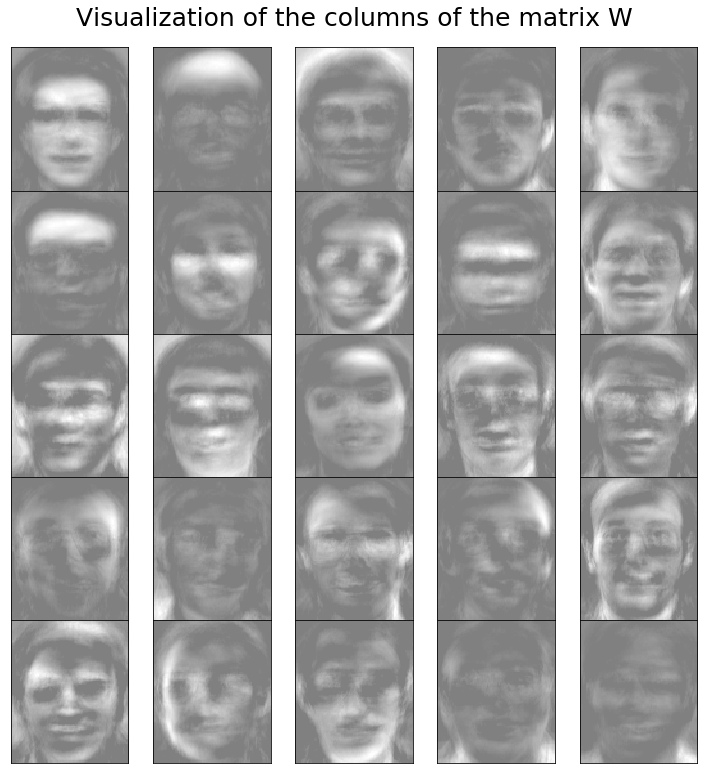

In [7]:
model = NMF(n_components=25)

W_true_sk = model.fit_transform(V)
H_true_sk = model.components_

plot_gallery("Visualization of the columns of the matrix W", W_true_sk.T)

#  Implementation of the EM algorithm

In [8]:
def EM(K, alpha, beta, n_it = 200):
    ah, aw = alpha
    ah -= 1
    aw -= 1
    bh, bw = beta
    
    # Random initialization of non-negative matrices around the mean of V 
    avg = np.sqrt(V.mean() / K)
    H = np.abs(avg * np.random.rand(K, n_samples))
    W = np.abs(avg * np.random.rand(n_features, K))
    # speed up a little bit computation and improve readibility
    cst_matrix = np.full
    
    for it in range(n_it):
        
        W *= (V / (W.dot(H))).dot(H.T)
        W += cst_matrix((n_features, K), aw)
        W /= cst_matrix((n_features, K), bw) + cst_matrix((n_features, n_samples), 1).dot(H.T)
        
        H *= W.T.dot(V / (W.dot(H)))
        H += cst_matrix((K, n_samples), ah)
        H /= cst_matrix((K, n_samples), bh) + W.T.dot(cst_matrix((n_features, n_samples), 1))
        
    return W, H, K



W_test, H_test, K_test = EM(25, (1,1), (1,1))  

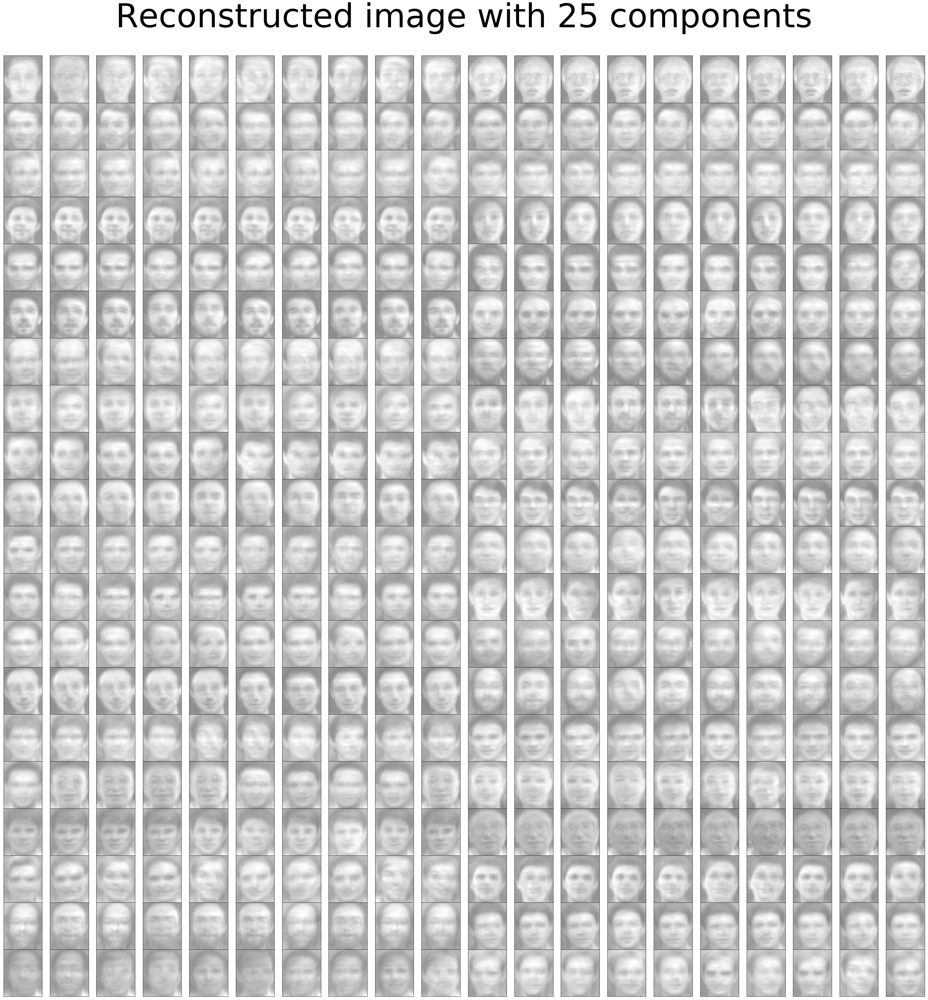

In [6]:
reconstructed_dataset = W_test.dot(H_test)


title = "Reconstructed image with {} components".format(K_test)
plot_gallery(title, reconstructed_dataset.T, 20, 20, 100)

# Visualization of the columns of the matrix $W$ 

### NB : Most of the figures are stored under img/ to limit file size

# Algorithm run with K, alpha fixed

We fix $K = 25$ and $\alpha = (1,1)$ to observe the influence of the $\beta$ parameter

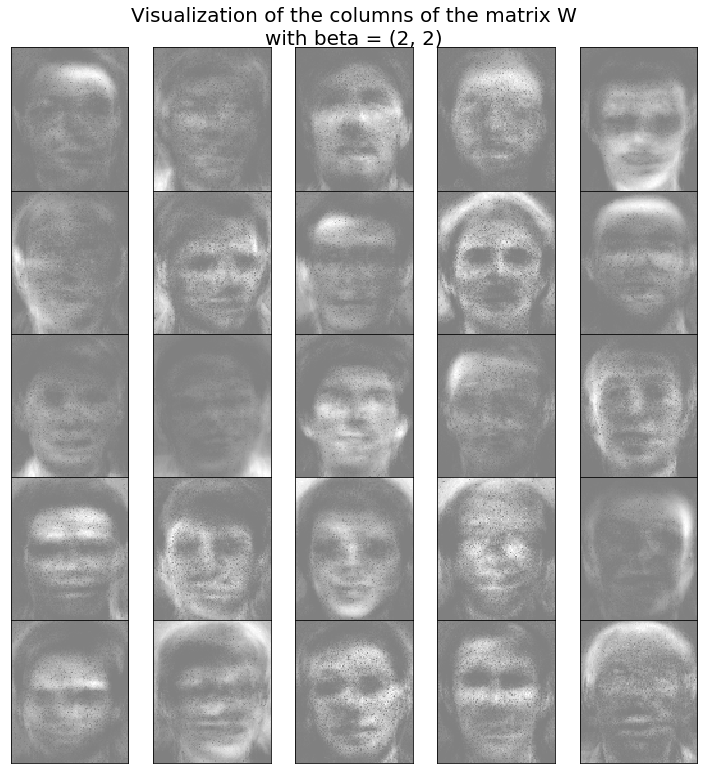

In [22]:
K = 25
alpha = (1,1)
# same values for bh and bw
# [(0, 0), (1, 1), (2, 2), (3, 3), (4, 4), (5, 5), (6, 6), (7, 7), (8, 8), (9, 9)]
beta_id  = [(i,i) for i in range(1,11)]
# random values for bh and bw
beta_rand = [np.random.rand(2) * i for i in range(1,11)]

for i, beta in enumerate(beta_id):
    W, _, _ = EM(K, alpha, beta, 100)
    if i==0:
        title   = "Visualization of the columns of the matrix W\nwith beta = {}".format(beta)
        plot_gallery(title, W.T, 5, 5, 20)
    else:
        title   = "columns_W_beta{}{}".format(beta[0], beta[1])
        plot_gallery(title, W.T, 5, 5, 20, True)
    




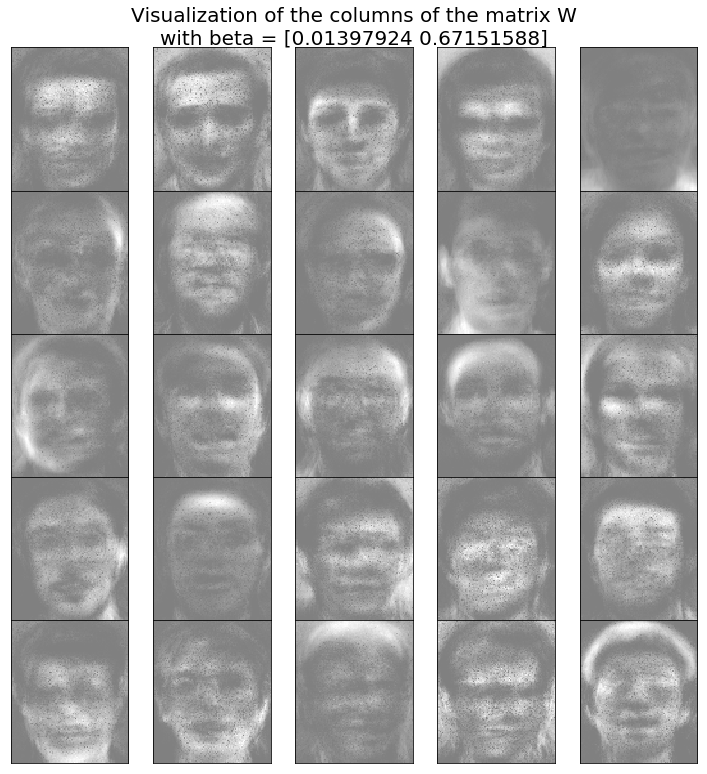

In [23]:
for i, beta in enumerate(beta_rand):
    W, _, _ = EM(K, alpha, beta, 100)
    if i==0:
        title   = "Visualization of the columns of the matrix W\nwith beta = {}".format(beta)
        plot_gallery(title, W.T, 5, 5, 20)
    else:
        title   = "columns_W_beta{}{}".format(round(beta[0], 2), round(beta[1],2))
        plot_gallery(title, W.T, 5, 5, 20, True)
    

# Algorithm run with K, beta fixed

We fix $K = 25$ and $\beta = (1,1)$ to observe the influence of the $\alpha$ parameter

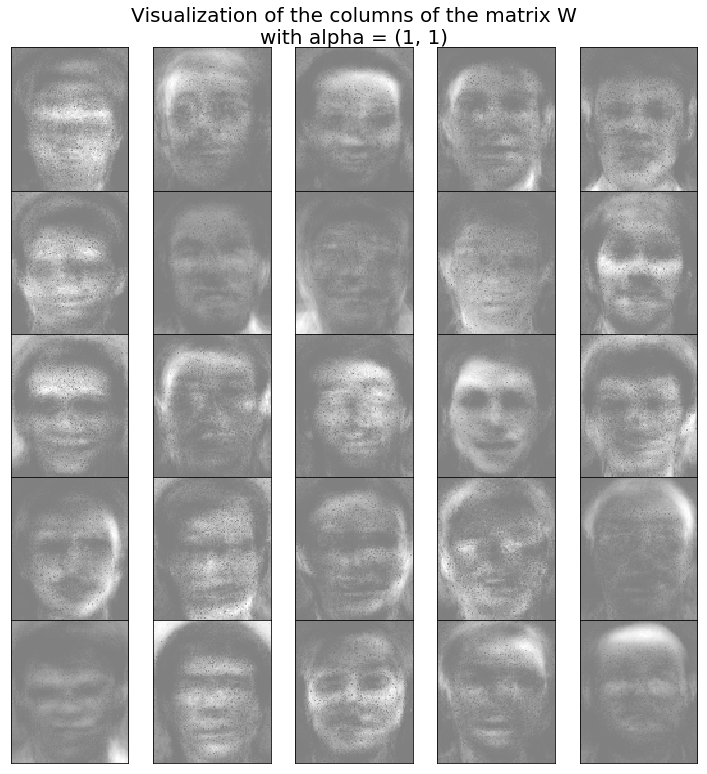

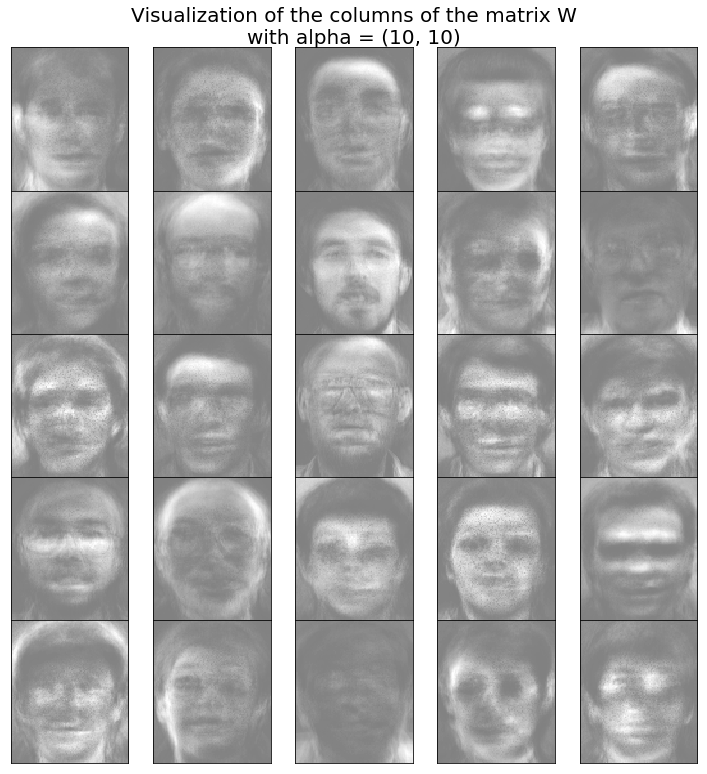

In [24]:
K = 25
alpha_id  = [(i,i) for i in range(1,11)]
beta  = (1,1)

for i, alpha in enumerate(alpha_id):
    W, _, _ = EM(K, alpha, beta, 100)
    if i==0 or i==9:
        title   = "Visualization of the columns of the matrix W\nwith alpha = {}".format(alpha)
        plot_gallery(title, W.T, 5, 5, 20)
    else:
        title   = "columns_W_alpha{}{}".format(alpha[0], alpha[0])
        plot_gallery(title, W.T, 5, 5, 20, True)
    


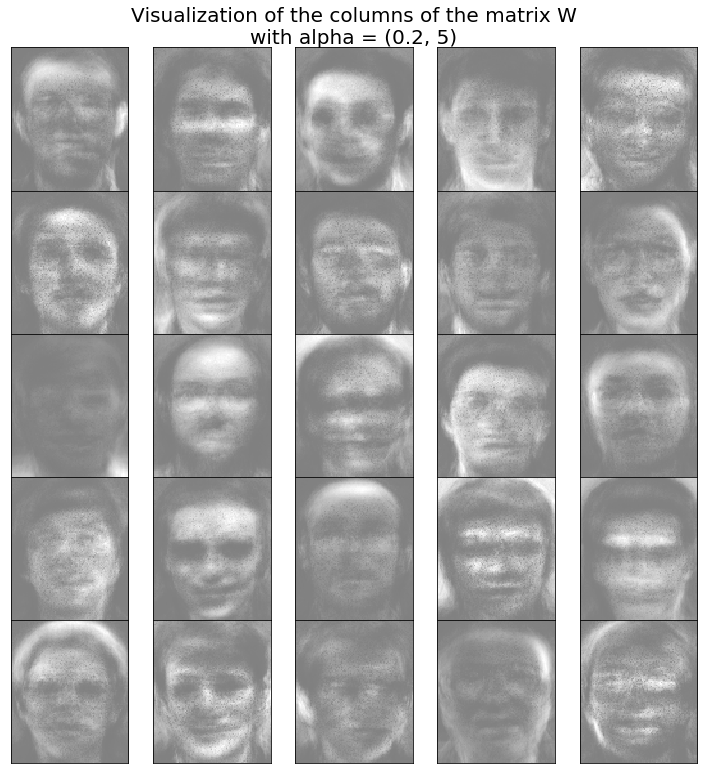

In [25]:
alpha_h_sparse = [(i, 0.2) for i in range(5,10)]
alpha_w_sparse = [(0.2, i) for i in range(5,10)]

for i, alpha in enumerate(alpha_w_sparse):
    W, _, _ = EM(K, alpha, beta, 100)
    if i==0:
        title   = "Visualization of the columns of the matrix W\nwith alpha = {}".format(alpha)
        plot_gallery(title, W.T, 5, 5, 20)
    else:
        title   = "columns_W_alpha{}{}".format(alpha[0], alpha[0])
        plot_gallery(title, W.T, 5, 5, 20, True)

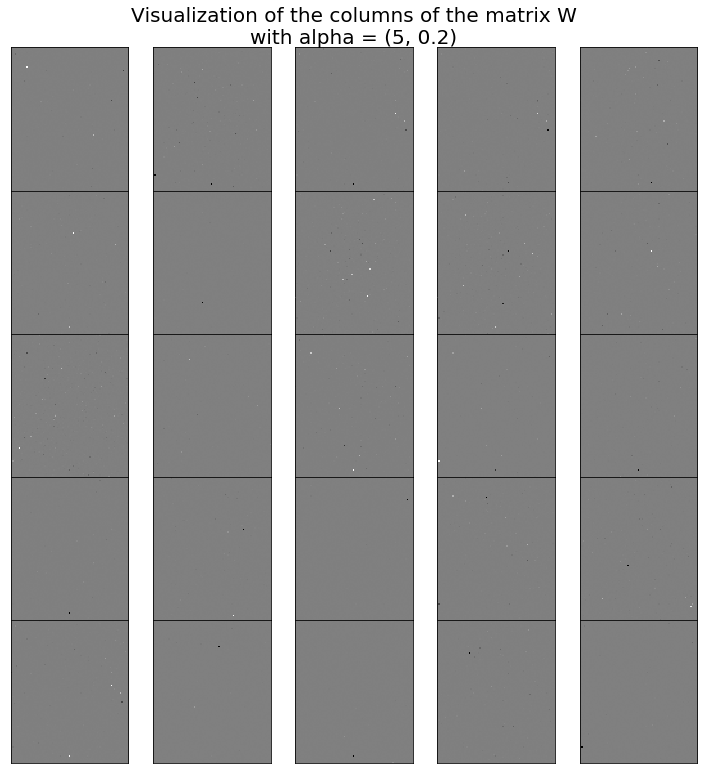

In [26]:
for i, alpha in enumerate(alpha_h_sparse):
    W, _, _ = EM(K, alpha, beta, 100)
    if i==0:
        title   = "Visualization of the columns of the matrix W\nwith alpha = {}".format(alpha)
        plot_gallery(title, W.T, 5, 5, 20)
    else:
        title   = "columns_W_alpha{}{}".format(alpha[0], alpha[0])
        plot_gallery(title, W.T, 5, 5, 20, True)

This result is obvious as we've chosen a very sparse representation of $W$, the plot will therefore be almost empy...

# Algorithm run with alpha, beta fixed

We fix $\beta = \alpha = (1,1)$ to observe the influence of the $K$ parameter

In [27]:
# From 25 components (high "compression") to 400 components (no dimensionality reduction)
# stored in /img

K = [25,42,100,156,196,240,306,400]
dim_plot = [(5,5), (6,7), (10,10), (12,13), (14,14), (15,16), (17,18), (20,20)]
alpha = (1,1)
beta  = (1,1)

for i, k in enumerate(K):
    n_row, n_col = dim_plot[i]
    W, _, _ = EM(k, alpha, beta, 100)
    title   = "columns_W_{}_components".format(k)
    plot_gallery(title, W.T, n_row, n_col, 20 + 4 * i, True)


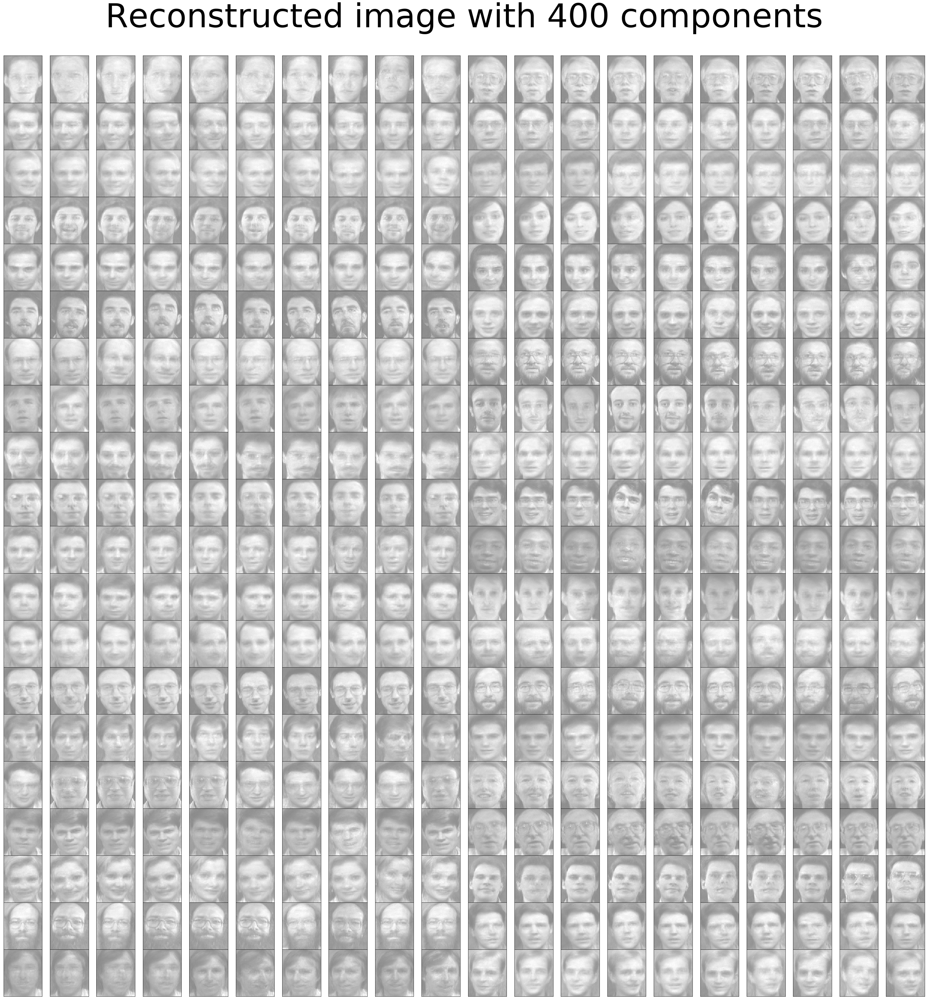

In [11]:
W_test, H_test, K_test = EM(400, (10,1), (1,100))  

reconstructed_dataset = W_test.dot(H_test)


title = "Reconstructed image with {} components".format(K_test)
plot_gallery(title, reconstructed_dataset.T, 20, 20, 100)

# Additional run : influence of one distribution over the other.

We're now fixing $K$, $\alpha_h, \beta_h$ and varying $\alpha_w, \beta_w$ (and reciprocally) to see the influence of one distribution over the other one.

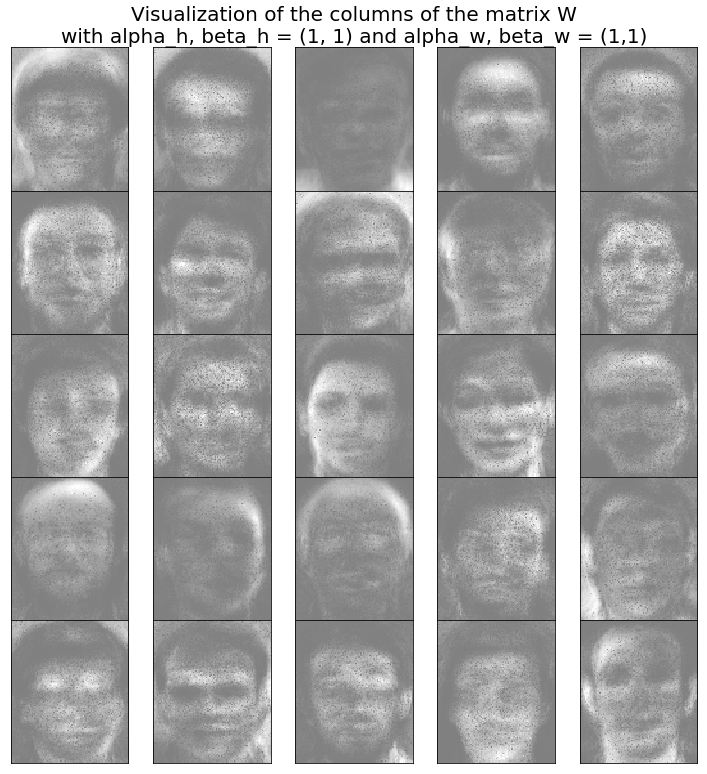

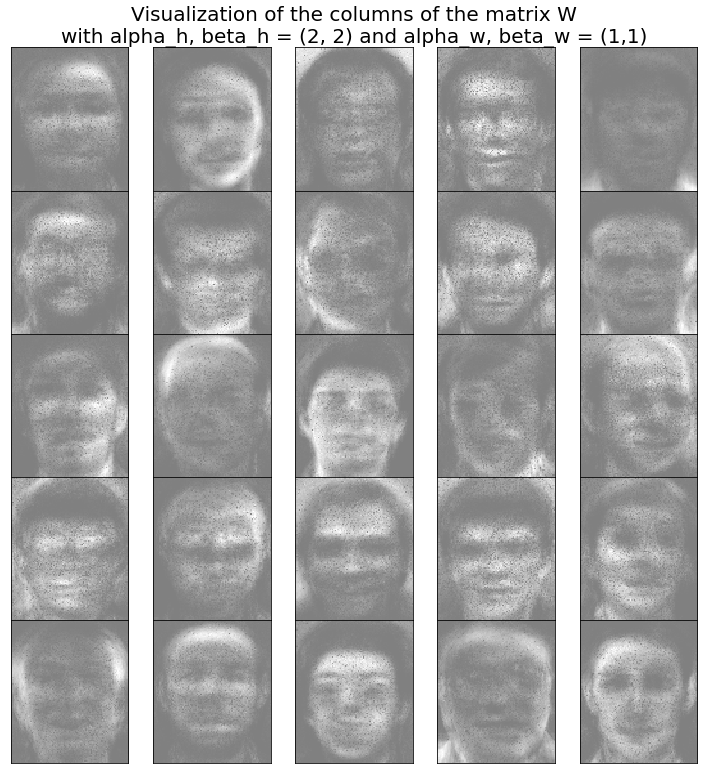

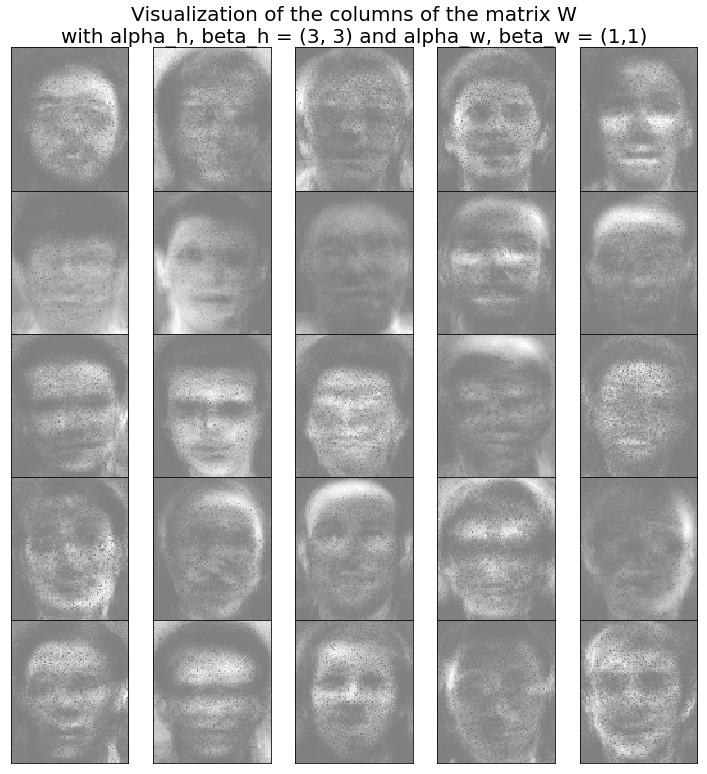

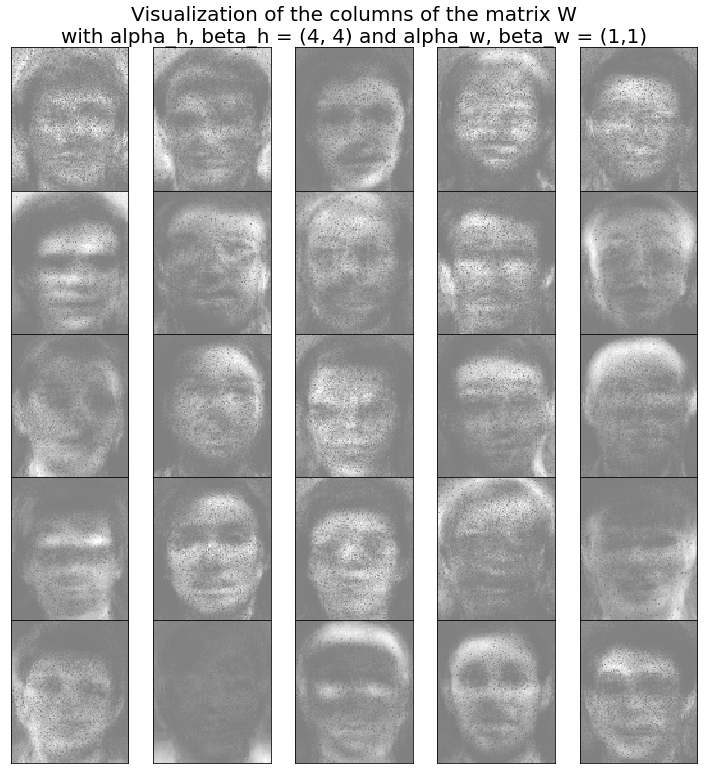

In [12]:
K = 25

alpha_h = [(i, 1) for i in range(1,5)]
beta_h  = [(i, 1) for i in range(1,5)]
alpha_w = [(1, i) for i in range(1,5)]
beta_w  = [(1, i) for i in range(1,5)]

for i, para in enumerate(alpha_h):
    W, _, _ = EM(K, para, beta_h[i], 80)
    title   = "Visualization of the columns of the matrix W\nwith alpha_h, beta_h = {} and alpha_w, beta_w = (1,1)".format((i+1, i+1))
    plot_gallery(title, W.T, 5,5, 20)
    
    

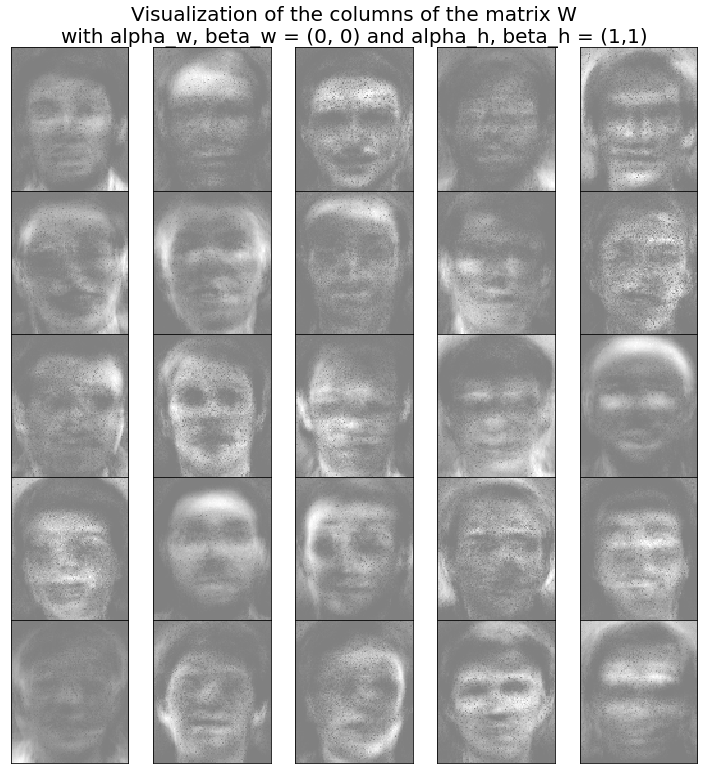

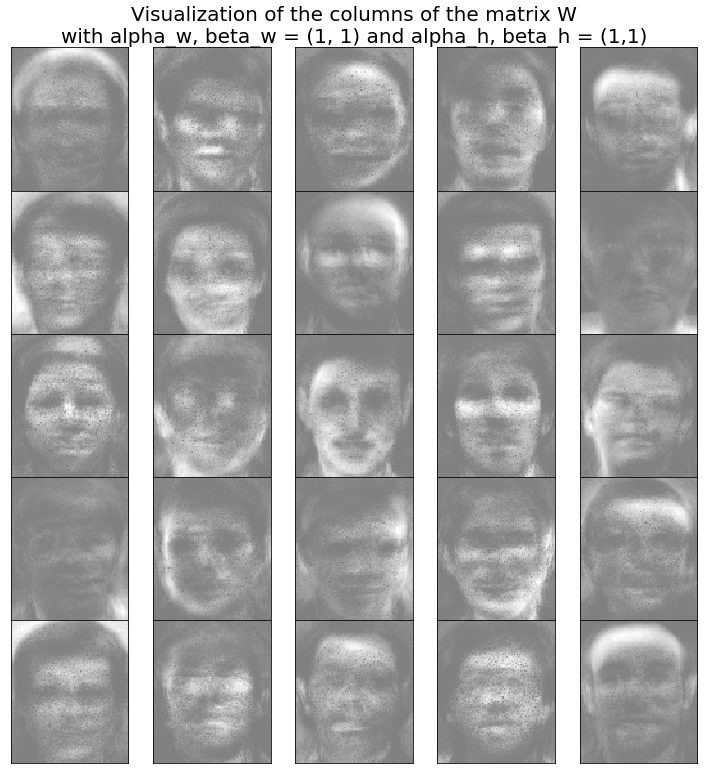

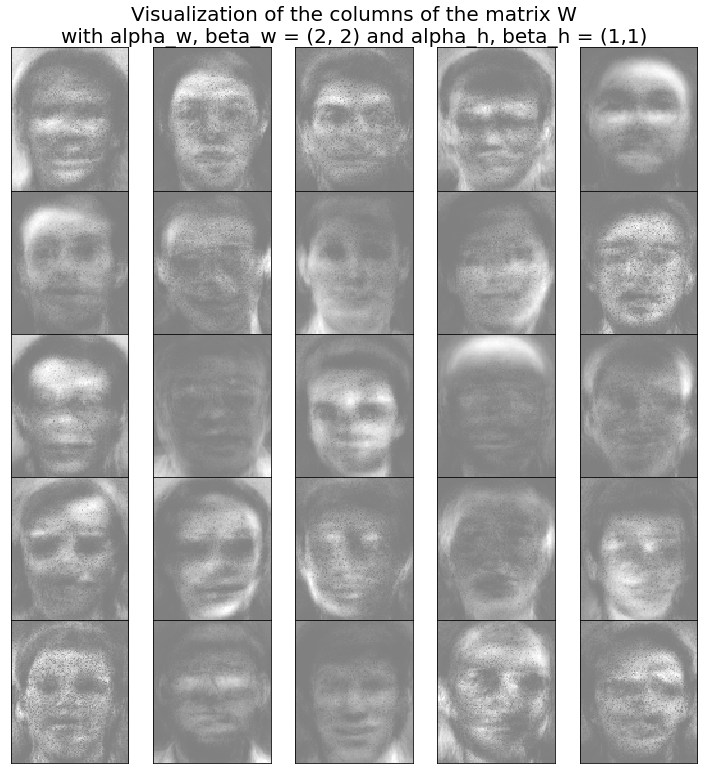

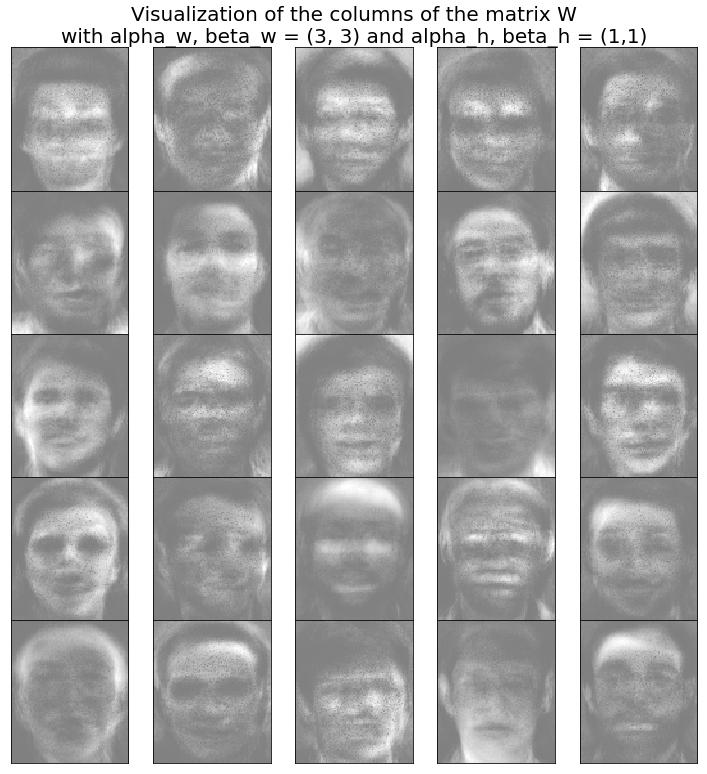

In [10]:
for i, para in enumerate(alpha_w):
    W, _, _ = EM(K, para, beta_w[i], 100)
    title   = "Visualization of the columns of the matrix W\nwith alpha_w, beta_w = {} and alpha_h, beta_h = (1,1)".format((i, i))
    plot_gallery(title, W.T, 5,5, 20)

# Conclusion

Let's recall that $v_{mn} = \sum_{k} s_{mnk}$ where each latent source $s_{mnk}$ is Poisson distributed with intensity $w_{mk} h_{kn}$ and those $w_{mk}, h_{kn}$ are Gamma distributed according to some parameters : $\alpha_{w,h}$, which are called shape parameters : they influence the shape of the curve of the gamma distribution, and $\beta_{w,h}$ wich are scaling parameters.

## Influence of $\alpha$ and $\beta$

As we see in the plots, if one parameter $\alpha$ is close to 0, the visualization of the columns of the matrix $W$ will be very "ugly". That is because $\alpha$ controls the sparsity of the components of the matrices $W$ and $H$. Having both $\alpha_h,w$ with a great value will lead to a dense representation. Having a sparse matrix $W$ implies that only little features will remain (like only the nose maybe for a dummy exemple) while having a sparse matrix $H$ implies that each face will be a weighted combination of very few features instead of a weighted combination of (almost) every features learned. The parameter $\beta$ is the mean or expected value for each distribution, it will influence the features chosen and the average weight to use for reconstruction. 


## Influence of $K$

If we look at NMF as a dimensionality reduction technique, as PCA for instance, we can see $K$ as the number of principal components. With a very small $K$, we assume that the data can be expressed with very few latent information. In our case the technique will try to learn $K$ relevant facial features and try to compress the information contained in our original dataset into those $K$ features, the lower $K$ is, the poorer the compression will be and the greater the loss of information will be. If we want our algorithm to be able to very well reconstruct the faces, we have to set $K$ with a high number, if we want our algorithm to be able to learn few relevant features and be able to still factorize it with decent performance, we can set $K$ with a low number, it's a trade-off complexity- compression power. Intuitively, this is because **each face can be seen as weighted average of the features** according to the weights stored in $H$, it is therefore easier to reconstruct each face if we have a lot of different features available.

## Discussion

It seemed weird for me to only compare the influence of $\alpha$ vs the $\beta$ while they were coming from two different distribution. Therefore I tried to vary the parameters of one distribution and to plot the evolution of $W$ while keeping the other paramaters constant. We can see that the gamma distribution associated with $W$ has great influence over the learned features which seems normal because we're plotting the matrix $W$ so if the distribution used to generate those points is changed, the matrix needs to change aswell. On the other hand, the gamma distribution of $H$ has a lot of impact too but it shouldn't change $W$ that much...